In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import torch
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
print(torch.cuda.is_available())

True


In [ ]:
#updated and working dataset class
import os
import torch
import torch.utils.data
import torchvision
from PIL import Image
from pycocotools.coco import COCO

#dataset_train = '/content/drive/MyDrive/Colab Notebooks/dataset/train'
#dataset_test = '/content/drive/MyDrive/Colab Notebooks/dataset/test'

class FootballDataset(torch.utils.data.Dataset):
    def __init__(self, dataset_path, annotation):
        #get the image files
        self.root = dataset_path
        #use the COCO api
        self.coco = COCO(dataset_path+annotation)
        #get the image ids of the images
        self.ids = list(sorted(self.coco.imgs))

    def __getitem__(self, idx):
        # Own coco file
        coco = self.coco
        #get the image id from idx
        img_id = self.ids[idx]

        #load image by getting image filename/filepath and opening it
        filepath = coco.loadImgs(img_id)[0]['file_name'] #loadImgs return the images list [{}], which has a dictionary inside it containing info about the img_id object, so the 0 index allows us to target the dictionary to get the 'file_name'
        img = torchvision.transforms.ToTensor()(Image.open(os.path.join(self.root, filepath)))

        #load the annotations by
        #geting all annotation ids from coco where the annotation image_id matches img_id (basically get all the bbox associated with that img_id)
        ann_ids = coco.getAnnIds(imgIds=img_id) #imgIds is simply part of the getAnnIds method
        #loading all annotation info from each ann_id in ann_ids
        coco_ann = coco.loadAnns(ann_ids)

        #go through all the ann_obs in coco_ann to get all the info, convert them to tensors, and add them in the lbls dictionary
        num_objs = len(coco_ann)

        boxes = []
        areas = []
        category_ids = []
        for i in coco_ann:
            #for bbox, Faster R-CNN wants the bbox to be in [xmin, ymin, xmax, ymax], not [xmin, ymin, width, height]
            xmin = i['bbox'][0]
            ymin = i['bbox'][1]
            xmax = xmin + i['bbox'][2]
            ymax = ymin + i['bbox'][3]
            boxes.append([xmin, ymin, xmax, ymax])
            category_ids.append(i['category_id']-1)
            areas.append(i['area'])

        # Convert to tensors
        boxes = torch.as_tensor(boxes, dtype=torch.int)
        labels = torch.as_tensor(category_ids, dtype=torch.int64)
        img_id = torch.tensor([img_id])
        areas = torch.as_tensor(areas, dtype=torch.float32)
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Annotation is in dictionary format
        lbls = {'image_id': img_id, 'labels': labels, 'boxes': boxes, 'area': areas, 'iscrowd': iscrowd}

        return img, lbls

    def __len__(self):
        return len(self.ids)

annotation_path = '/_annotations.coco.json'

train_dataset = FootballDataset(dataset_path='/content/drive/MyDrive/Colab Notebooks/dataset/train',
                                   annotation=annotation_path)
train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                          batch_size = 1,
                                          shuffle = True,
                                          num_workers = 4) #num_workers = how many sub-processes for CPU to use for data loading (GPU doesn't have to wait as long)

test_dataset = FootballDataset(dataset_path='/content/drive/MyDrive/Colab Notebooks/dataset/test',
                                        annotation=annotation_path)
test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                          batch_size = 1,
                                          shuffle = False,
                                          num_workers = 4) #num_workers = how many sub-processes for CPU to use for data loading (GPU doesn't have to wait as long)


loading annotations into memory...
Done (t=0.05s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
#train model with transformed images
import os
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.transforms import v2
from torchvision import tv_tensors
os.environ['CUDA_LAUNCH_BLOCKING']='1'

def get_model_instance_segmentation(num_classes):
    # load an instance segmentation model pre-trained pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weight=None)
    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model


# 4 classes: player, referee, ball, goalkeeper
num_classes = 4
num_epochs = 10 #10
model = get_model_instance_segmentation(num_classes)

# move model to the right device
model.to(device)

# parameters
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

len_dataloader = len(train_dataloader)

#transforms
transforms = v2.Compose([
    v2.RandomVerticalFlip(p=0.2),
    v2.RandomHorizontalFlip(p=0.2),
])

for epoch in range(num_epochs):
    model.train()
    iter_loss = 0
    for i, (imgs, annotations) in enumerate(train_dataloader):
        #imgs = list(img.to(device) for img in imgs)
        imgs = imgs.to(device)
        annotations = [{k: v.to(device) for k, v in annotations.items()}] #basically k is equal to the value of key (to device) for each annotations.items() and v is equal to the actual value of each key in annotation.items()
        annotations[0]['labels'] = annotations[0]['labels'][0] #remove the 1 in the labels torch size (originally [1,24] but we want just [24])
        annotations[0]['boxes'] = annotations[0]['boxes'][0] #remove the 1 in the boxes torch size (originally [1,24,4] but we want just [24, 4])
        H,W = torchvision.transforms.functional.get_image_size(imgs)[0], torchvision.transforms.functional.get_image_size(imgs)[1]
        boxes = tv_tensors.BoundingBoxes(annotations[0]['boxes'], format="XYXY", canvas_size=(H, W), dtype=torch.int)
        imgs, annotations[0]['boxes'] = transforms(imgs, boxes)
        loss_dict = model(imgs, annotations)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        iter_loss += losses
        #print(f'Iteration: {i}/{len_dataloader}, Loss: {losses}')
    print(f'Iteration: {epoch+1}/{num_epochs}, Average iteration loss: {iter_loss/len_dataloader}')

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 69.1MB/s]


Iteration: 1/10, Average iteration loss: 1.1697361469268799
Iteration: 2/10, Average iteration loss: 0.8446316123008728
Iteration: 3/10, Average iteration loss: 0.6970969438552856
Iteration: 4/10, Average iteration loss: 0.5963253378868103
Iteration: 5/10, Average iteration loss: 0.5403541326522827
Iteration: 6/10, Average iteration loss: 0.4978560507297516
Iteration: 7/10, Average iteration loss: 0.4836512506008148
Iteration: 8/10, Average iteration loss: 0.42549413442611694
Iteration: 9/10, Average iteration loss: 0.46847689151763916
Iteration: 10/10, Average iteration loss: 0.4042800962924957


In [ ]:
#Nhu trying to figure out the draw function
import matplotlib.pyplot as plt
from torchvision.io import read_image
from torchvision.utils import draw_bounding_boxes

def draw_function(img, boxes, labels):
    labels_names = ['Ball', 'Goalkeeper', 'Player', 'Referee'] #each index of labels_name will refer to the categories id
    colors = [(255,255,0), (100,100,100), (255,0,255), (0,255,255)] #each index of colors will refer to each class
    colors_list = [] #adjust each color to each category id (for instance color (255,255,0) is for category_id 0 = 'Ball')
    label_to_names = [] #adjust the names to each category id
    for i in labels: #for each labeled object (category_ids)
        label_to_names.append(labels_names[i])
        colors_list.append(colors[i])
    img_sample = (img[0]*255).to(torch.uint8)
    img = draw_bounding_boxes(img_sample, boxes, labels=label_to_names, width=3, colors=colors_list)
    img = torchvision.transforms.ToPILImage()(img)
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.show()




In [ ]:
!pip install torch torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 806.1/806.1 kB 16.9 MB/s eta 0:00:00


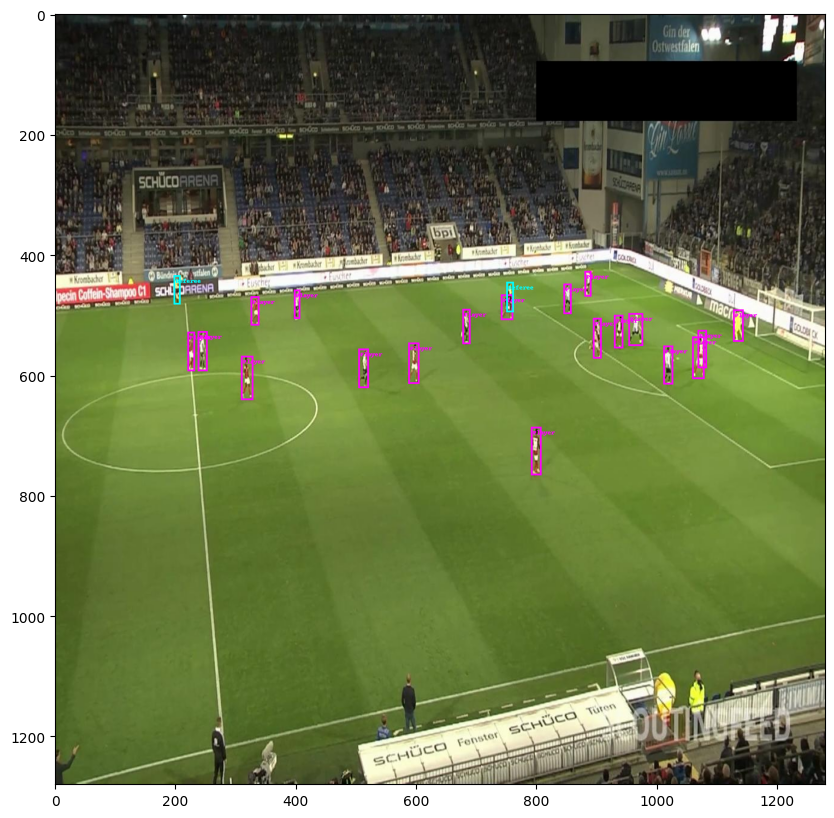

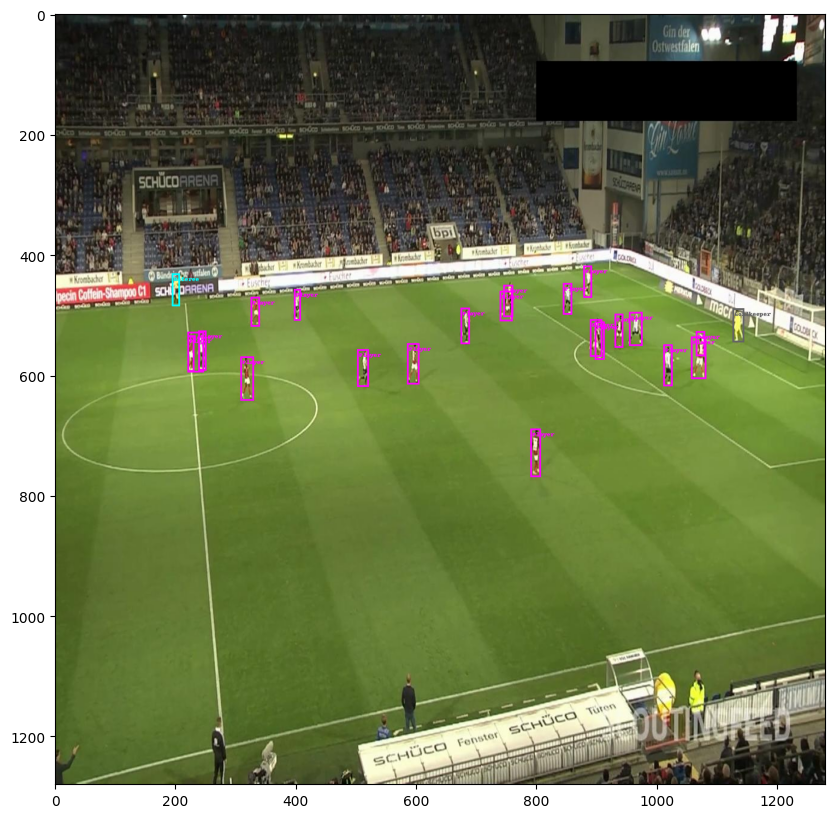

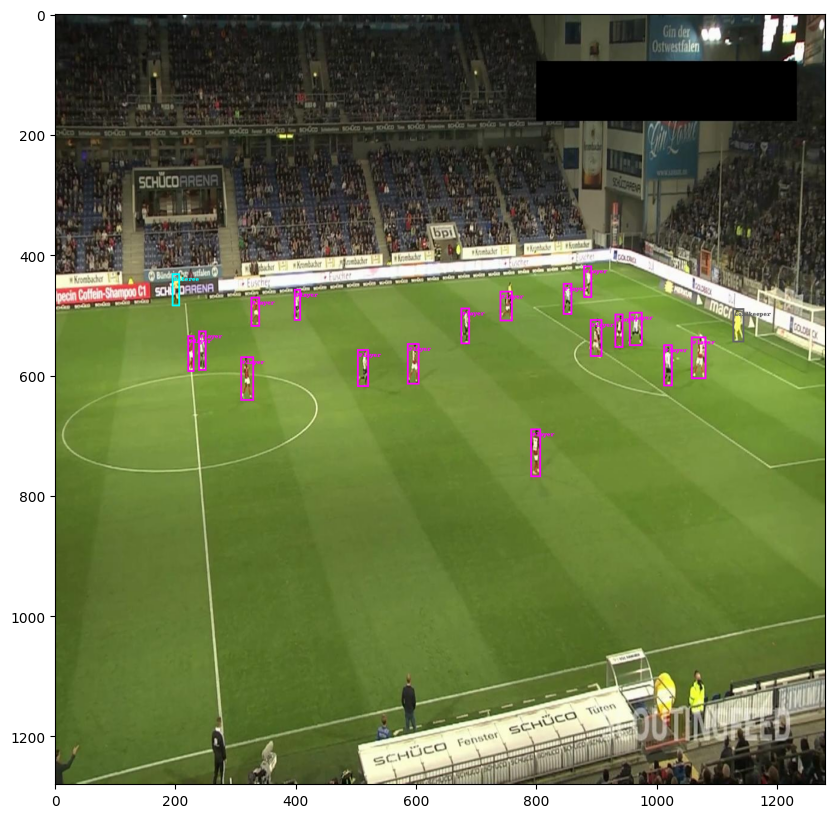

{'iou': tensor(0.0593, device='cuda:0')}
{'iou': tensor(0.0436, device='cuda:0')}
{'iou': tensor(0.0461, device='cuda:0')}


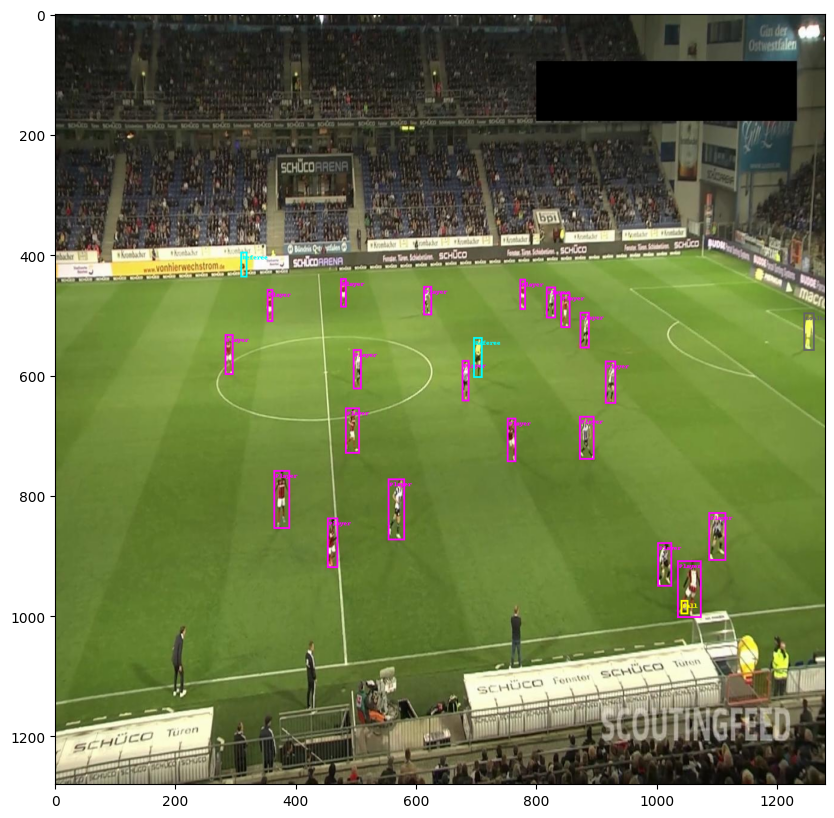

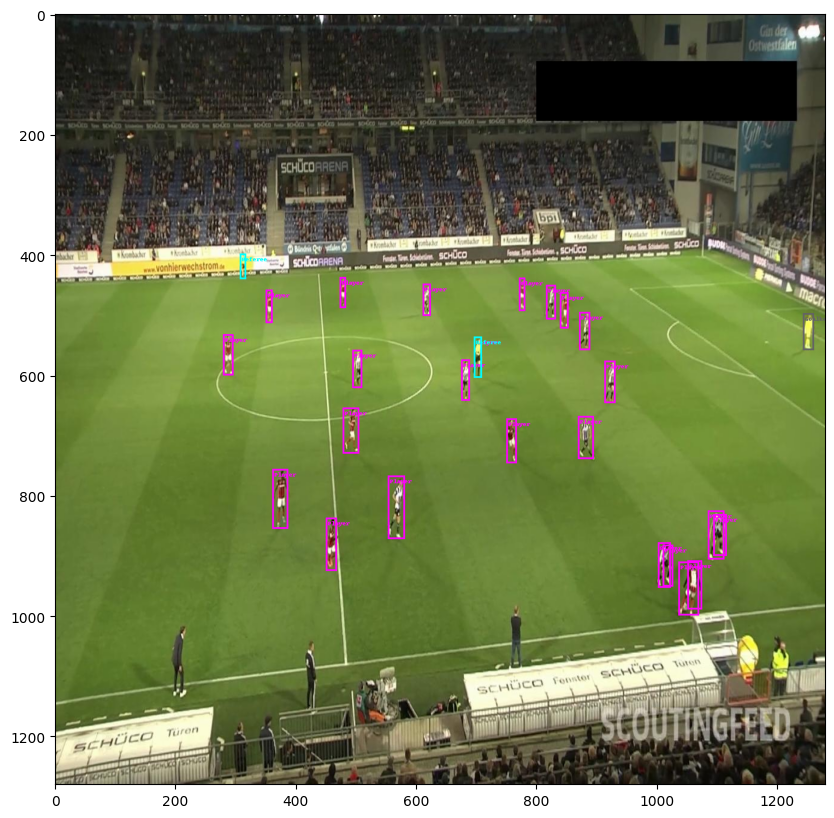

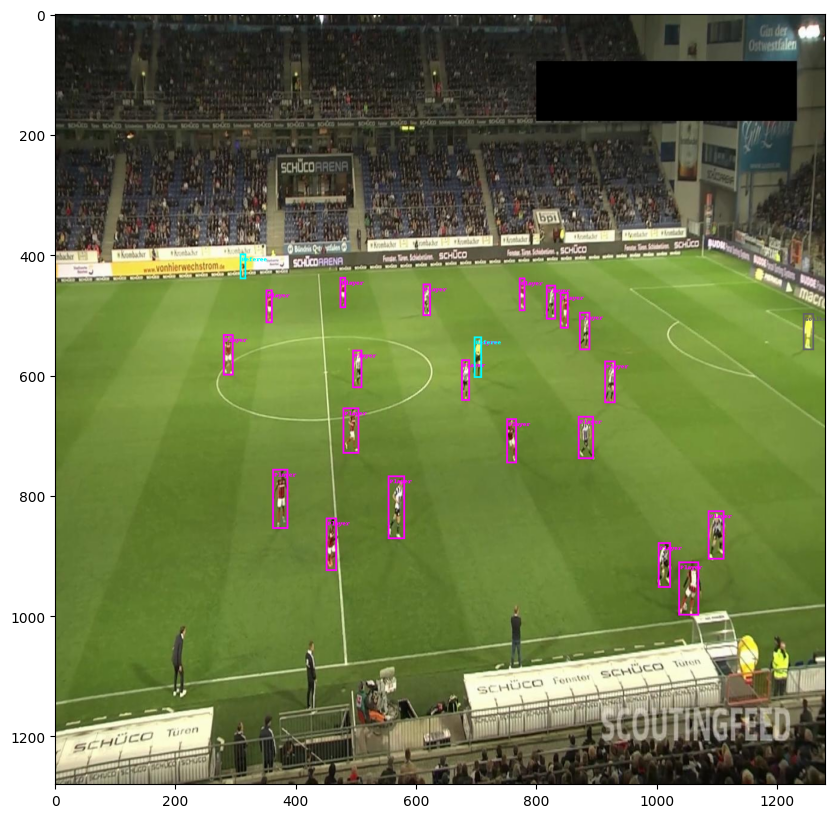

{'iou': tensor(0.0591, device='cuda:0')}
{'iou': tensor(0.0436, device='cuda:0')}
{'iou': tensor(0.0461, device='cuda:0')}


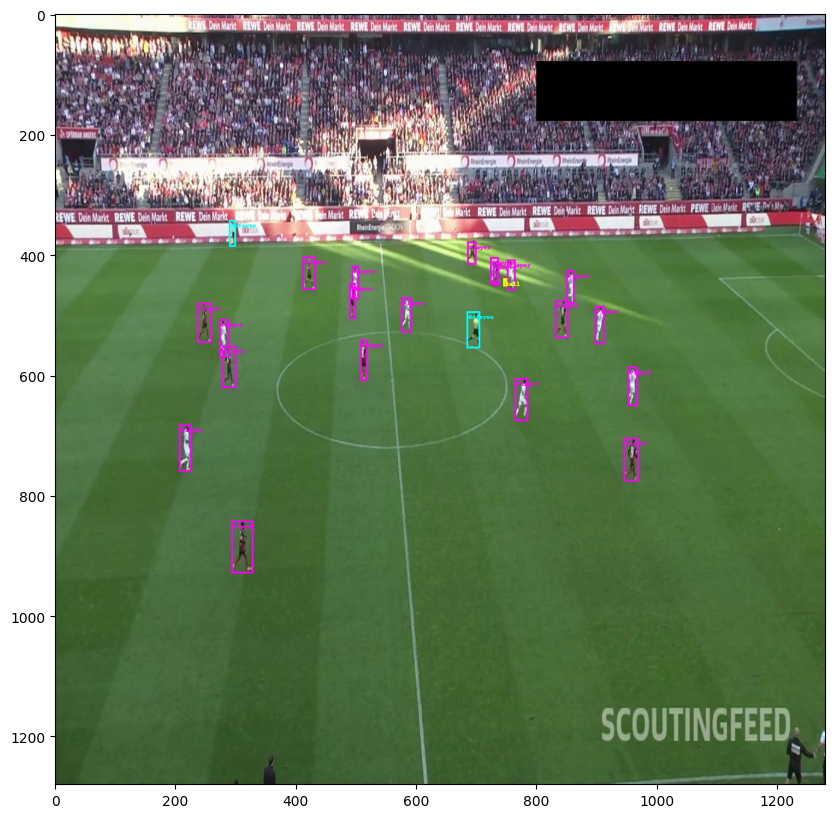

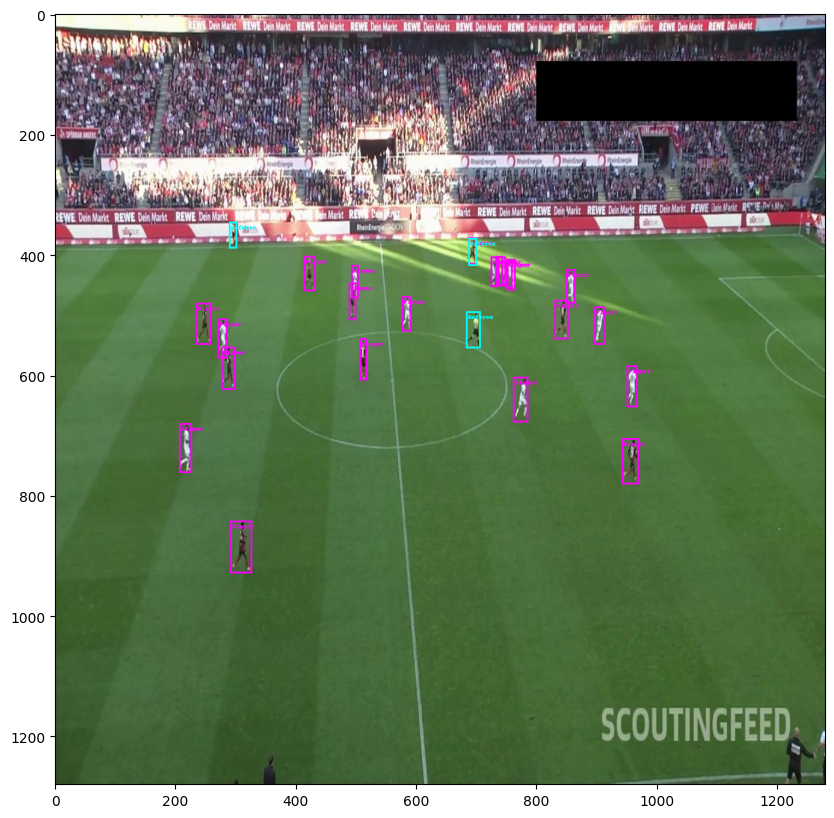

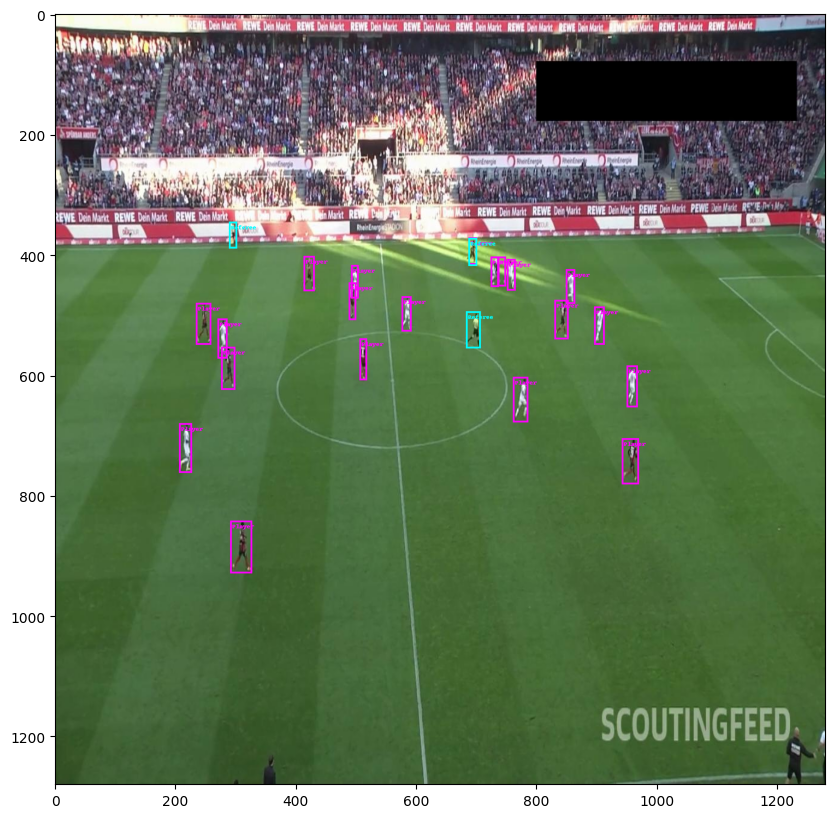

{'iou': tensor(0.0605, device='cuda:0')}
{'iou': tensor(0.0441, device='cuda:0')}
{'iou': tensor(0.0458, device='cuda:0')}


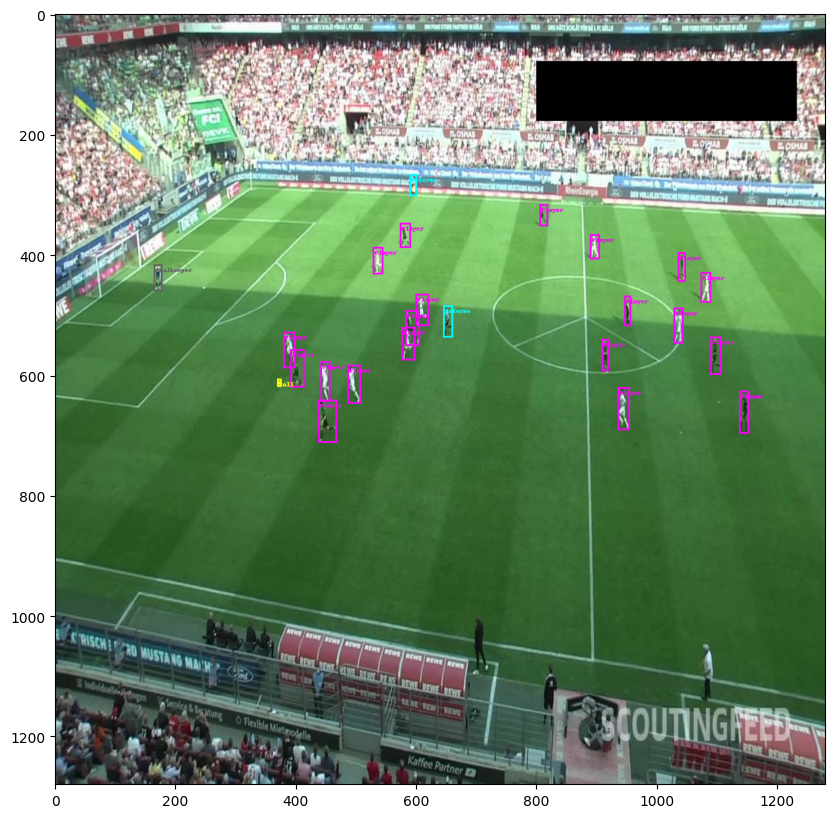

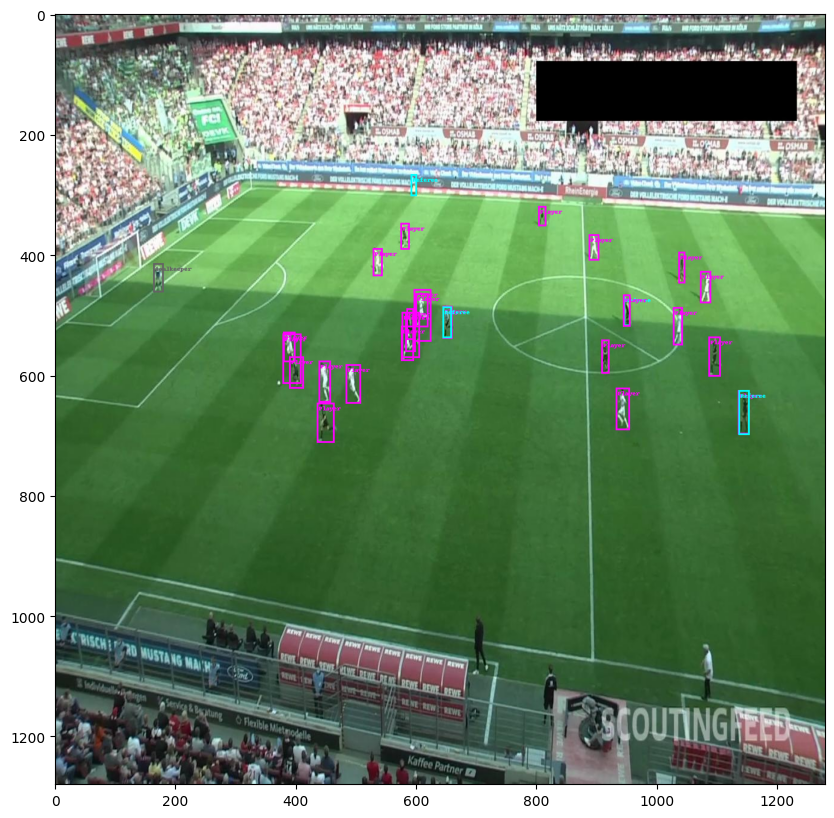

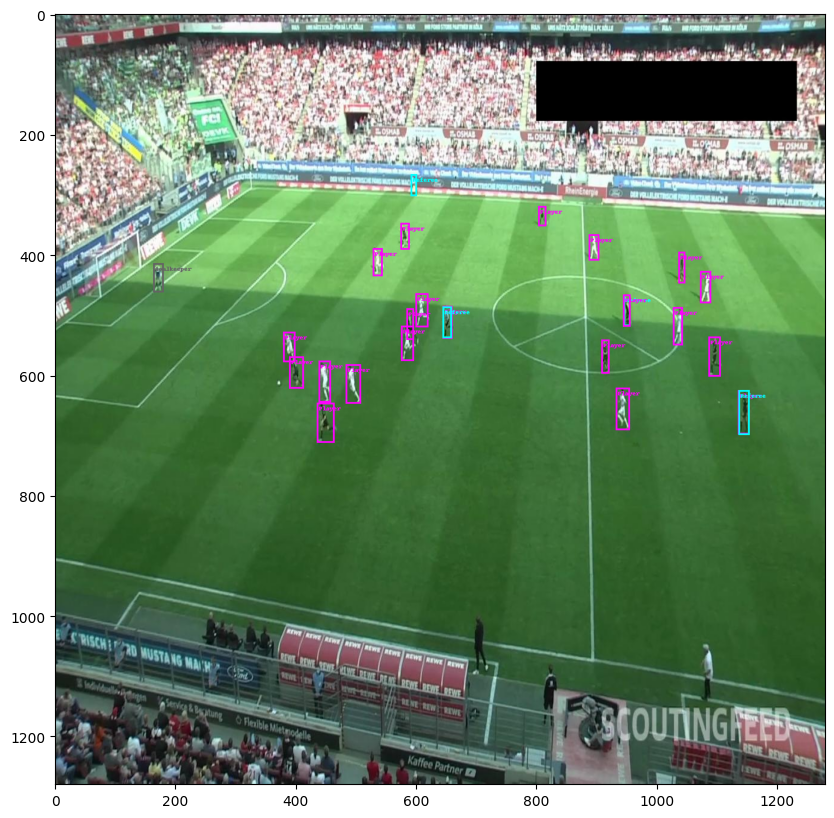

{'iou': tensor(0.0612, device='cuda:0')}
{'iou': tensor(0.0437, device='cuda:0')}
{'iou': tensor(0.0437, device='cuda:0')}


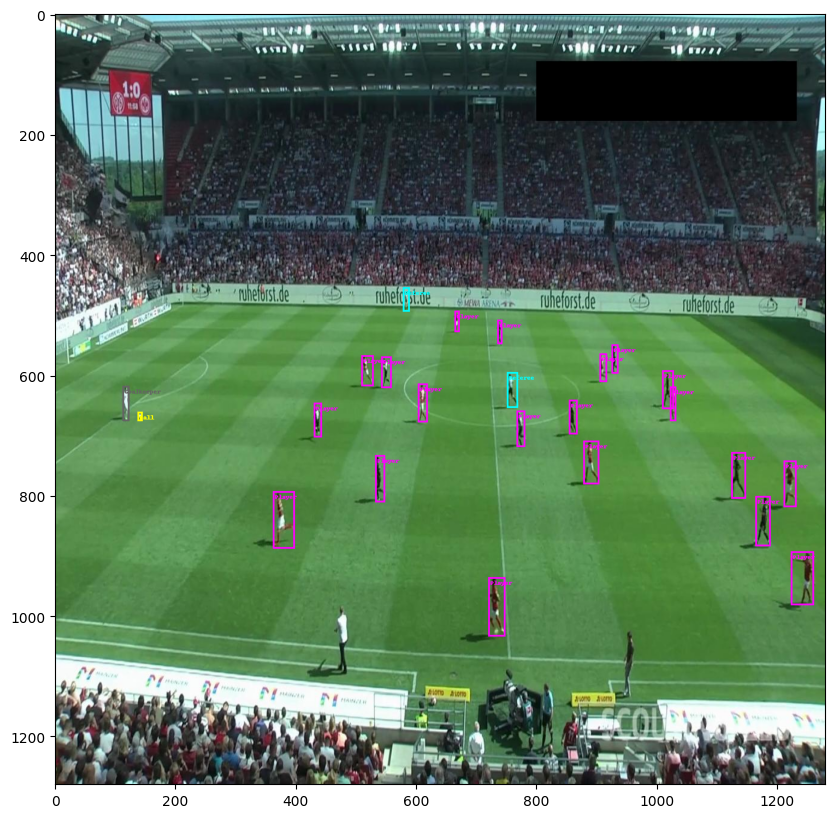

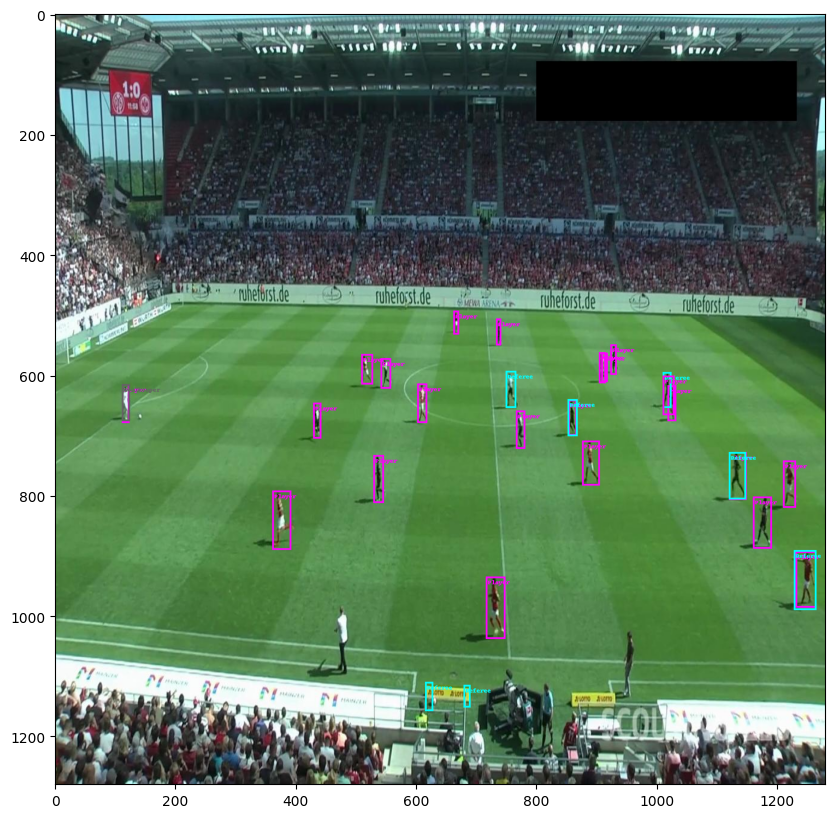

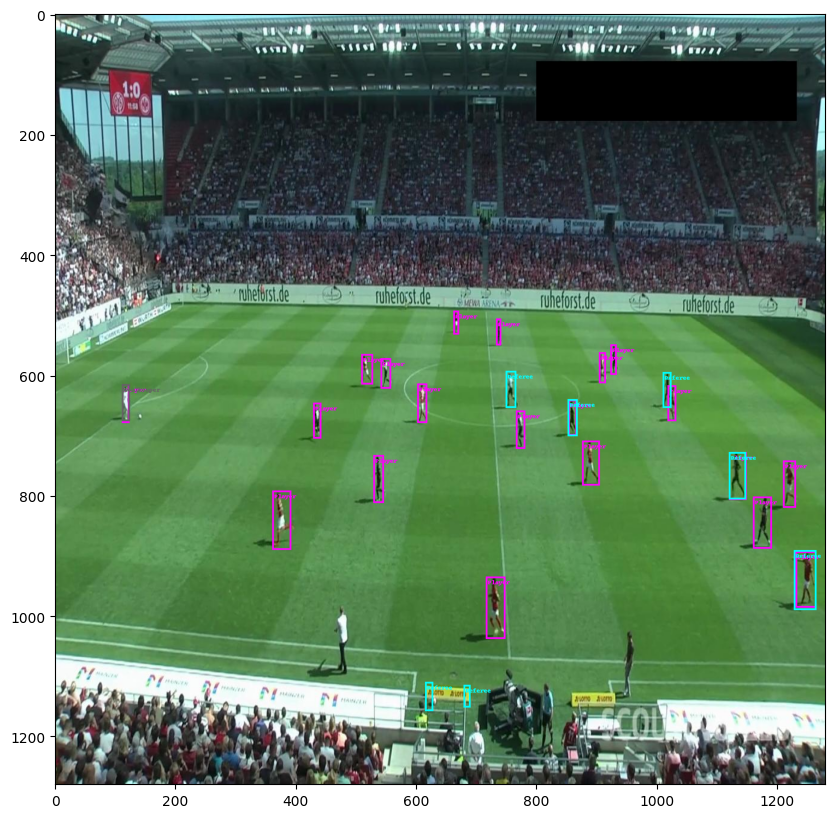

{'iou': tensor(0.0598, device='cuda:0')}
{'iou': tensor(0.0409, device='cuda:0')}
{'iou': tensor(0.0412, device='cuda:0')}


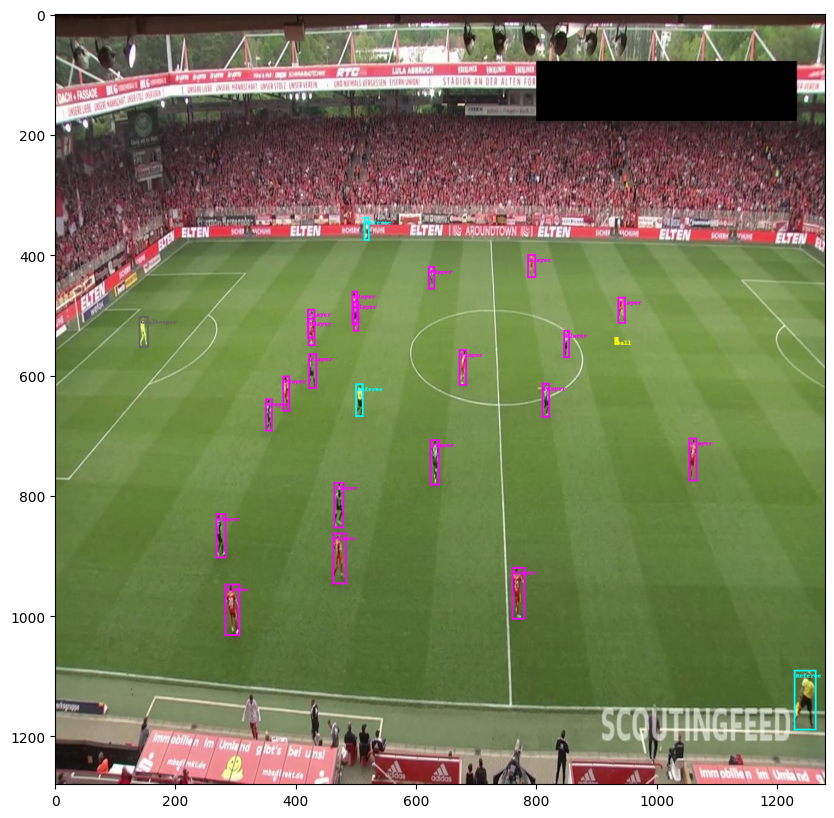

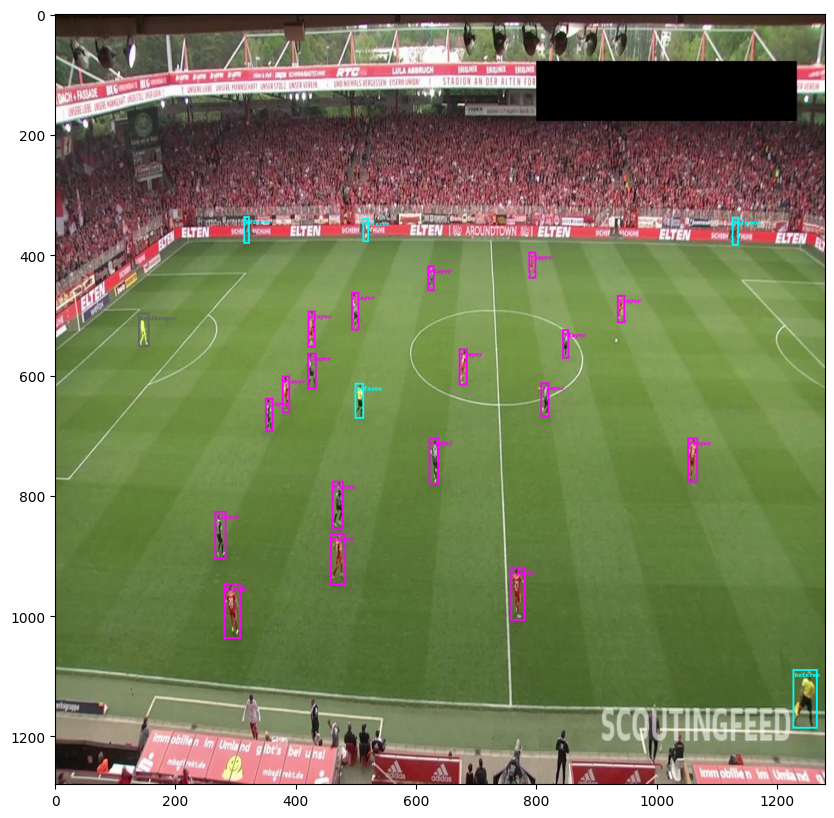

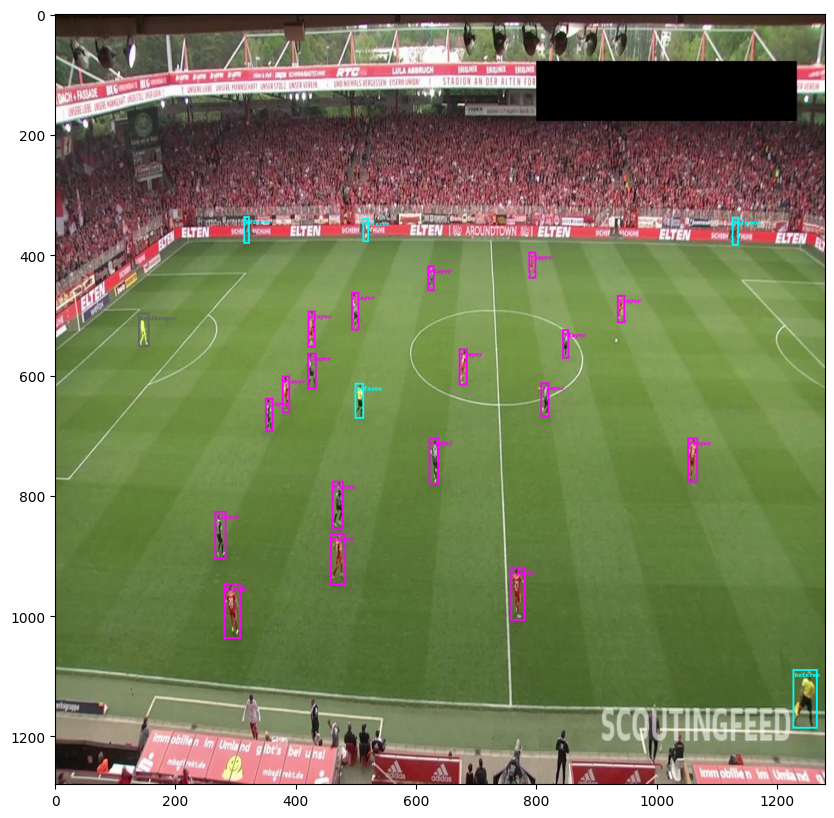

{'iou': tensor(0.0653, device='cuda:0')}
{'iou': tensor(0.0510, device='cuda:0')}
{'iou': tensor(0.0510, device='cuda:0')}


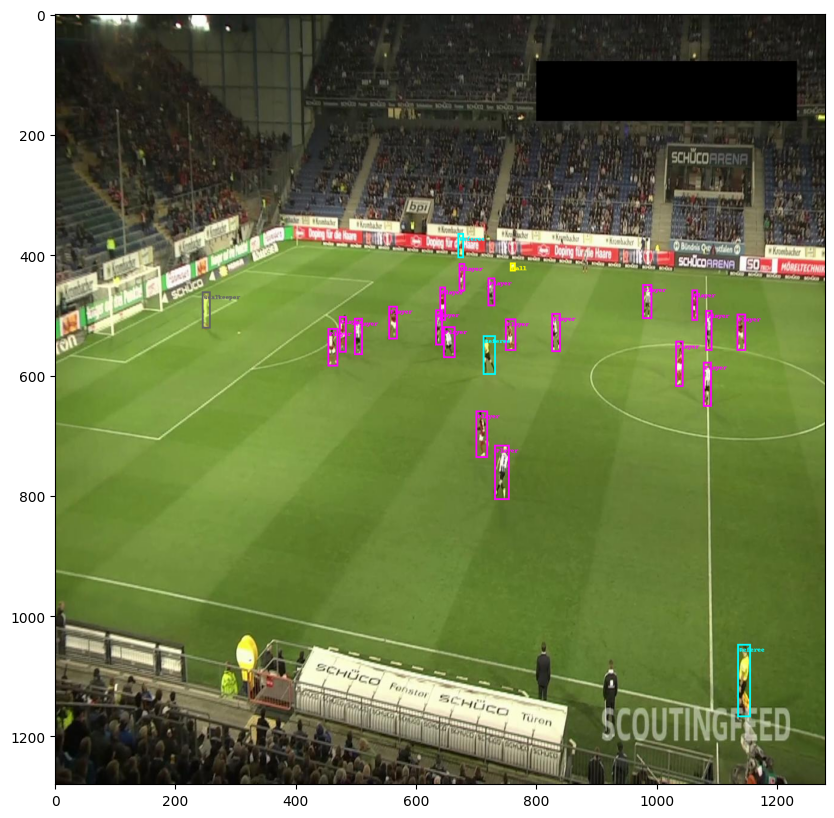

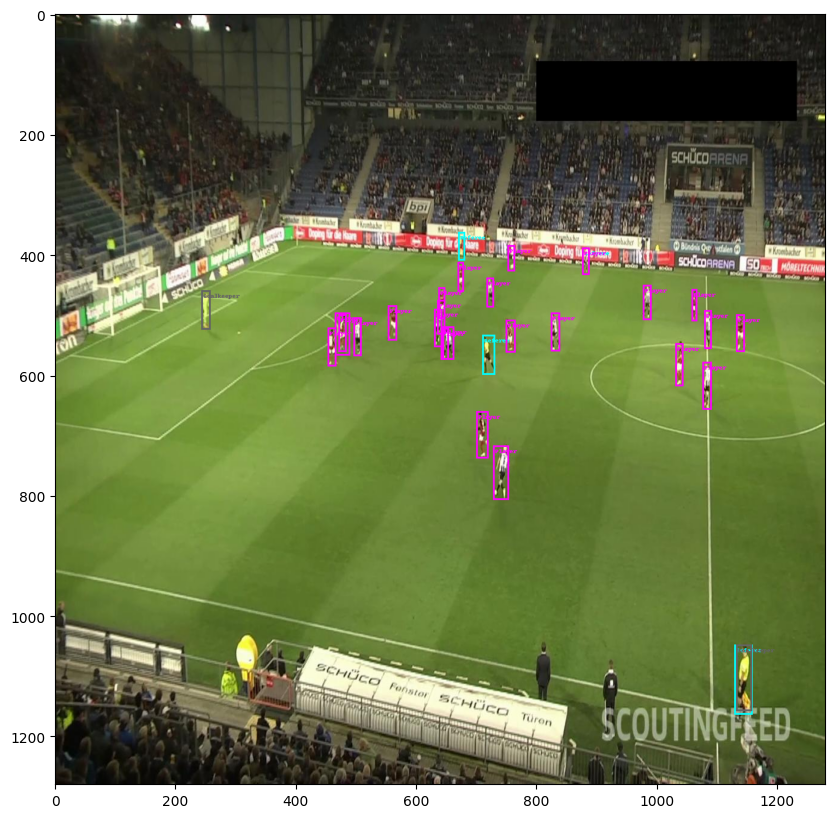

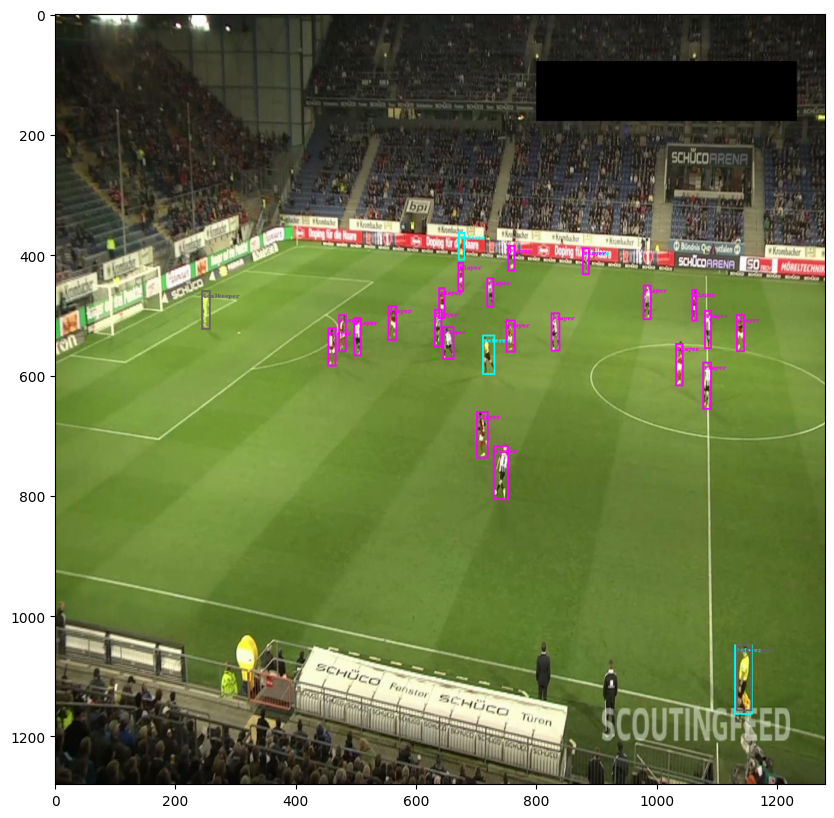

{'iou': tensor(0.0649, device='cuda:0')}
{'iou': tensor(0.0435, device='cuda:0')}
{'iou': tensor(0.0457, device='cuda:0')}


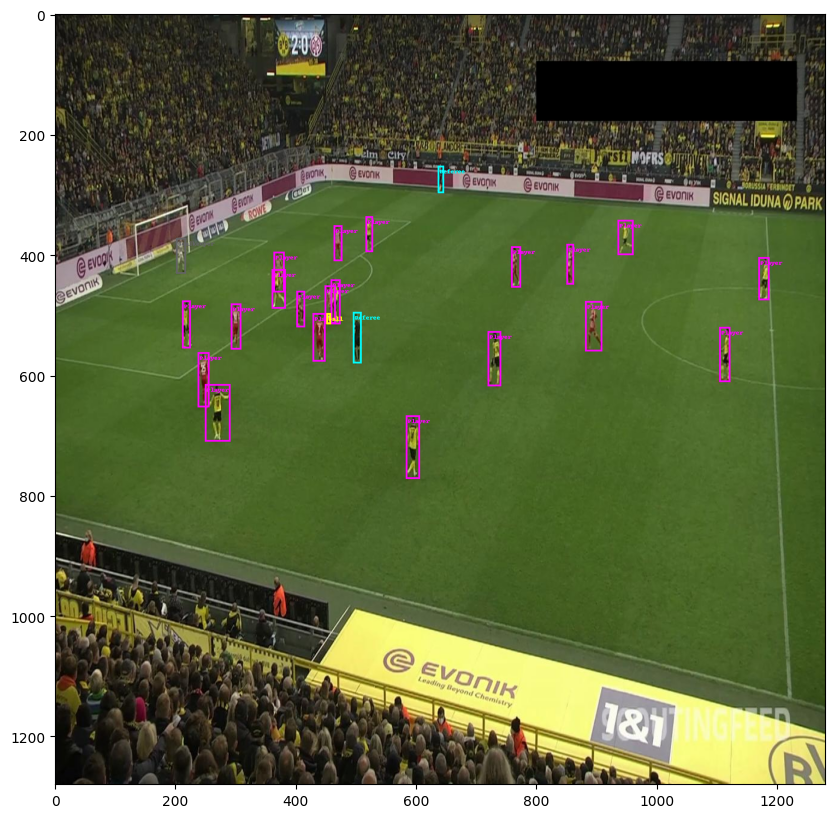

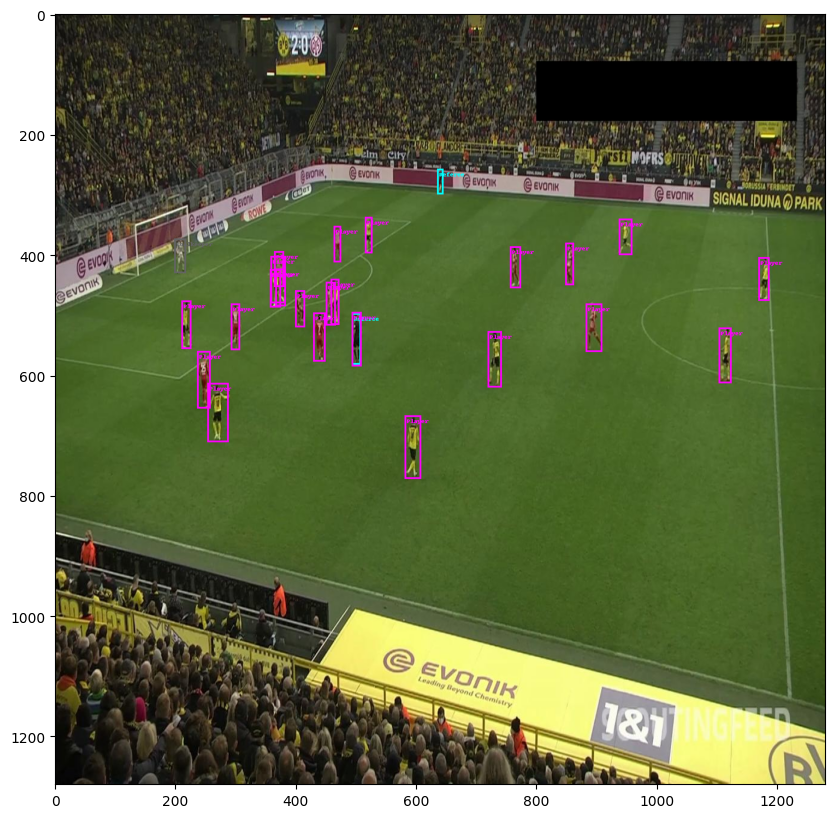

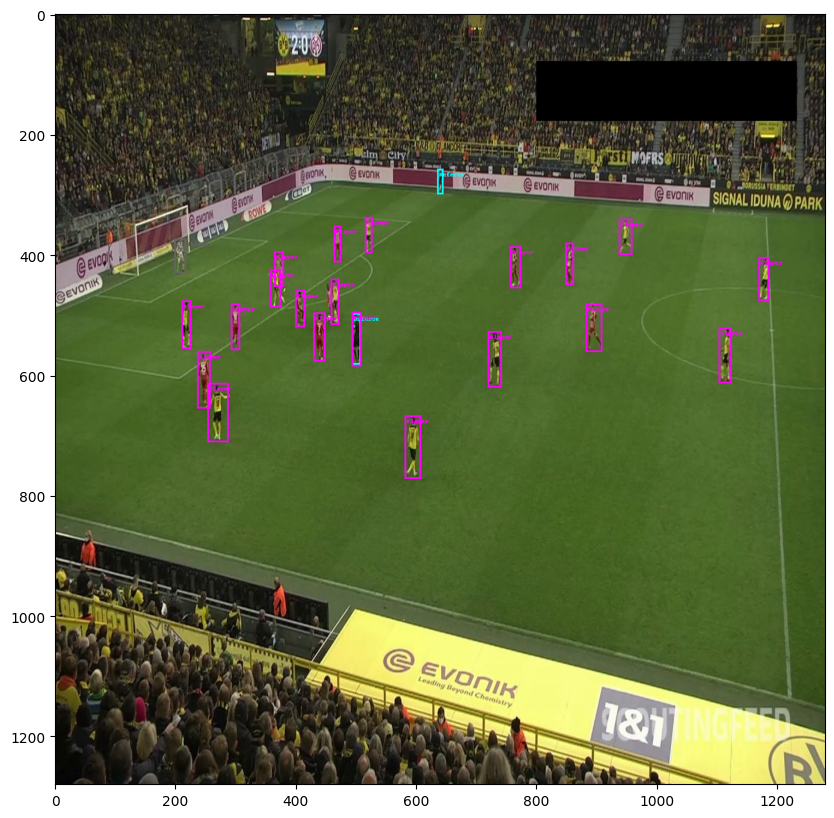

{'iou': tensor(0.0624, device='cuda:0')}
{'iou': tensor(0.0484, device='cuda:0')}
{'iou': tensor(0.0476, device='cuda:0')}


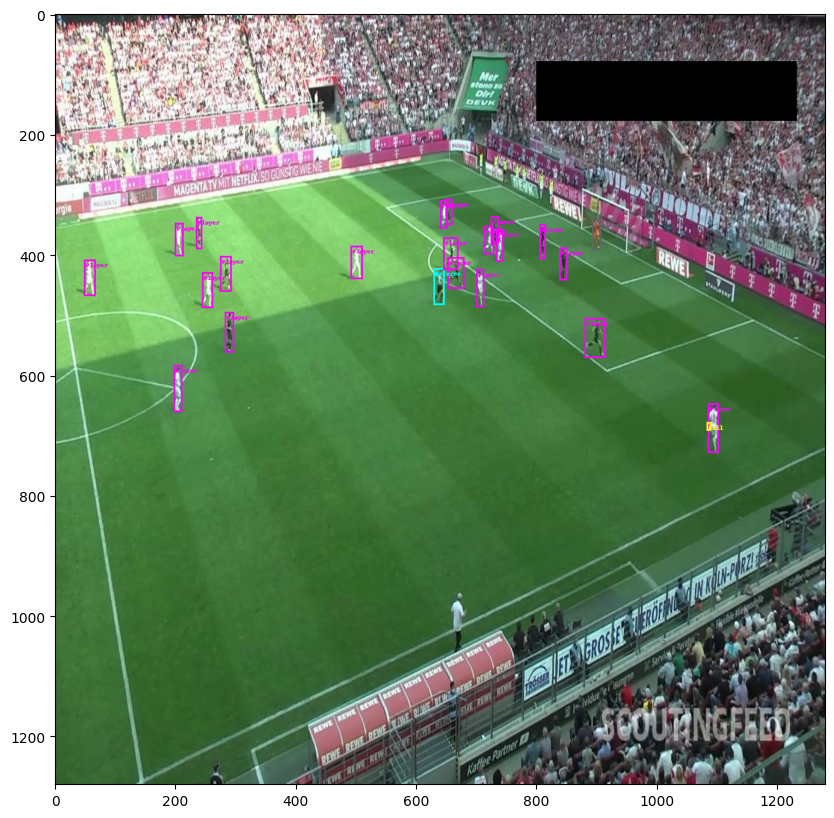

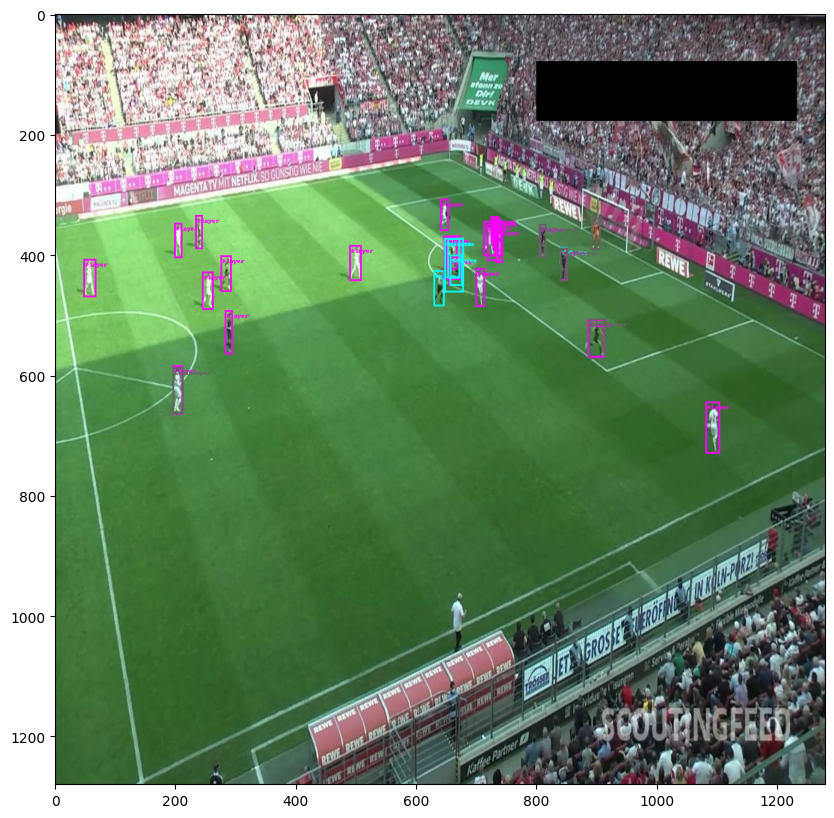

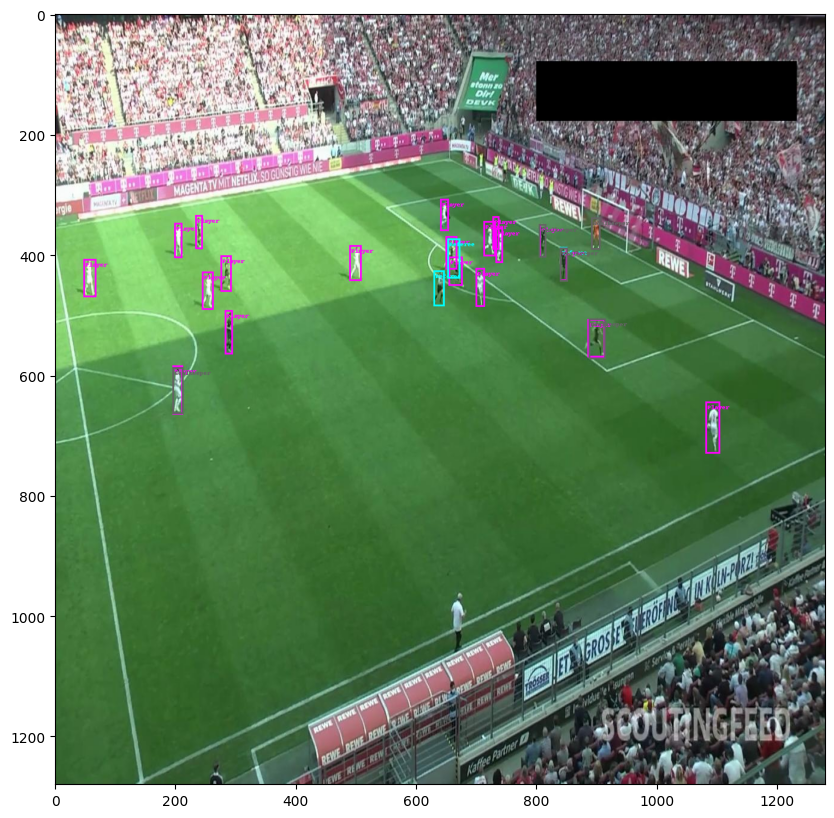

{'iou': tensor(0.0596, device='cuda:0')}
{'iou': tensor(0.0448, device='cuda:0')}
{'iou': tensor(0.0455, device='cuda:0')}


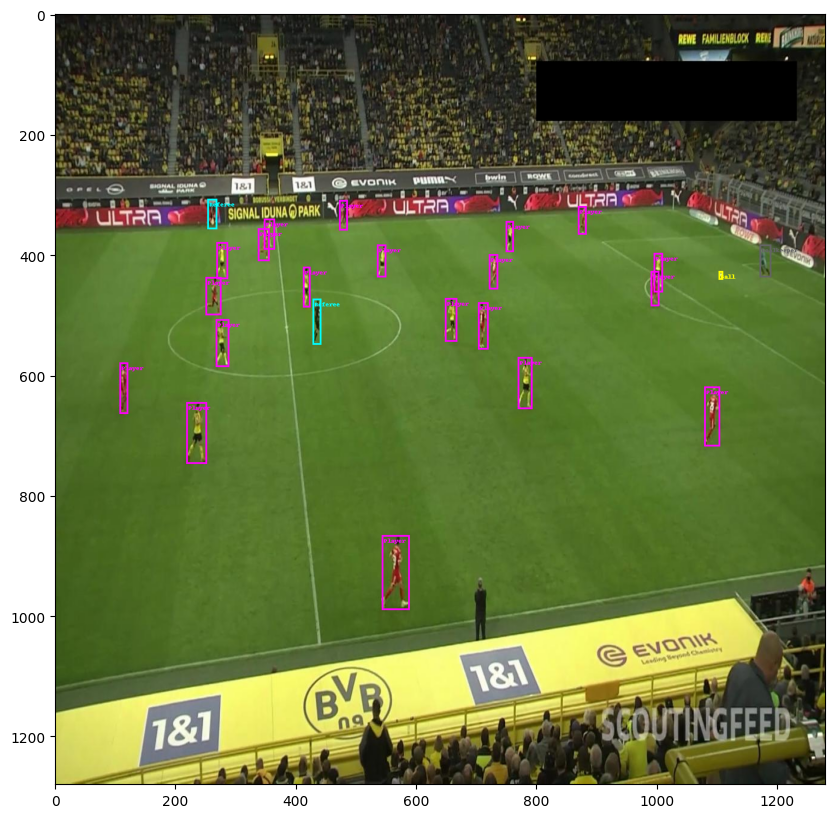

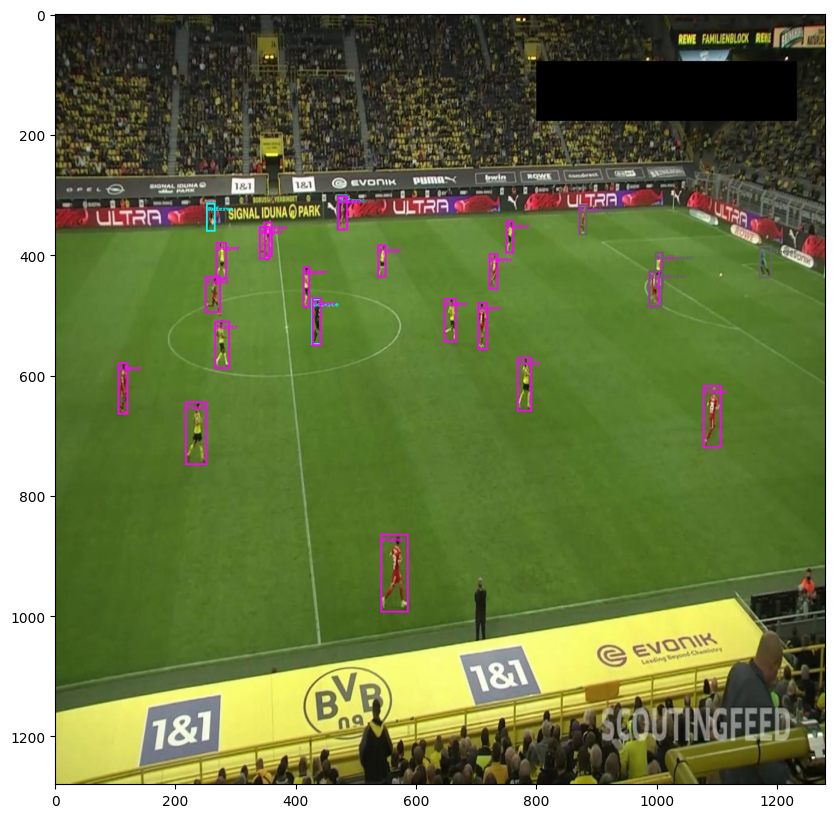

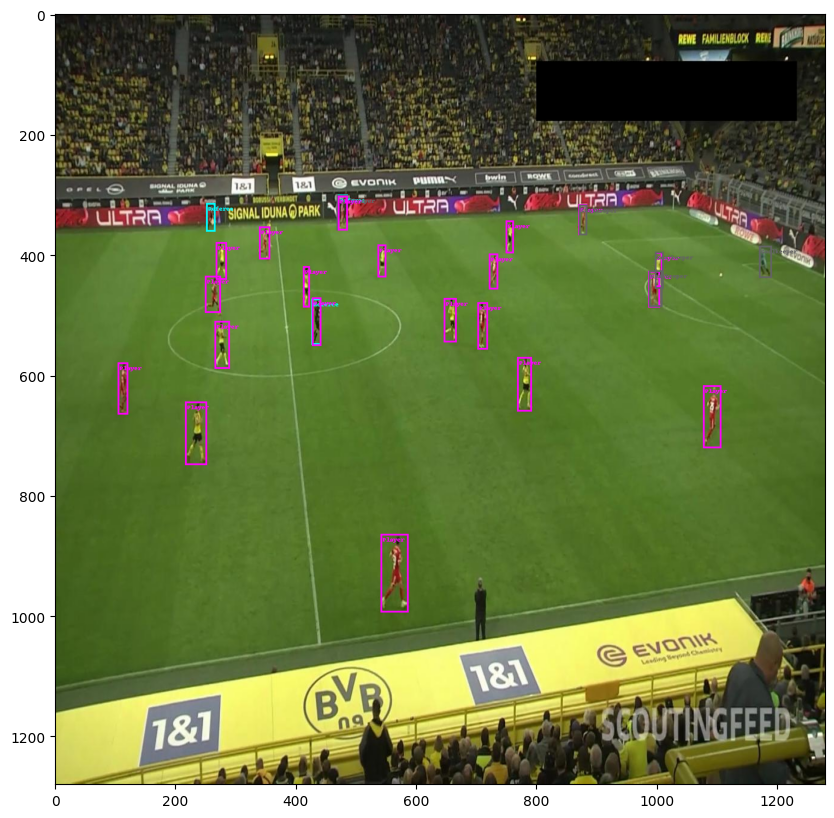

{'iou': tensor(0.0612, device='cuda:0')}
{'iou': tensor(0.0459, device='cuda:0')}
{'iou': tensor(0.0460, device='cuda:0')}


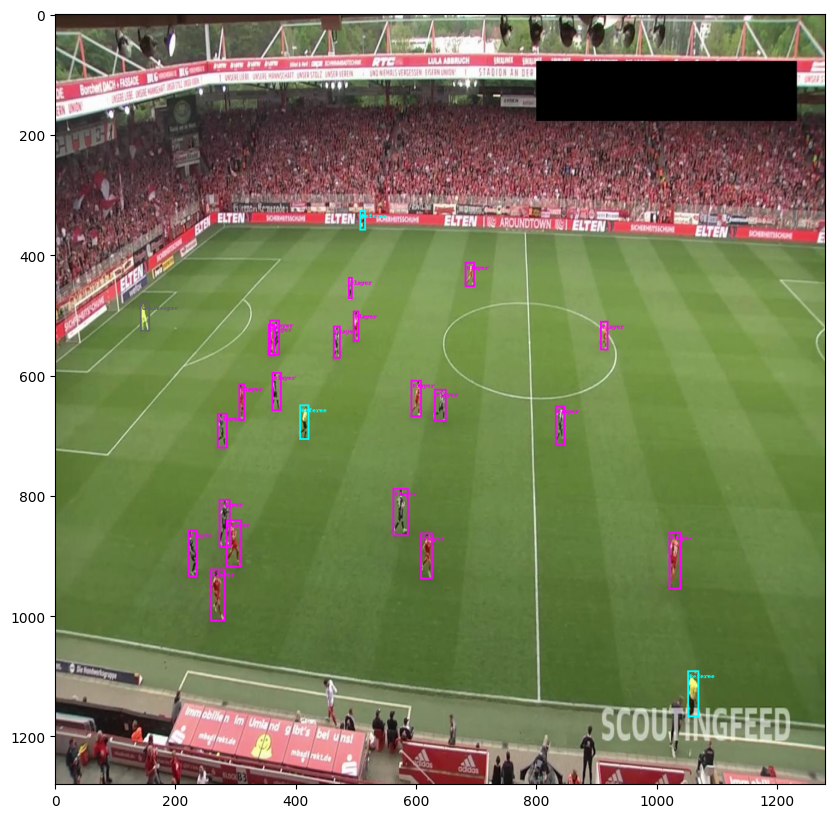

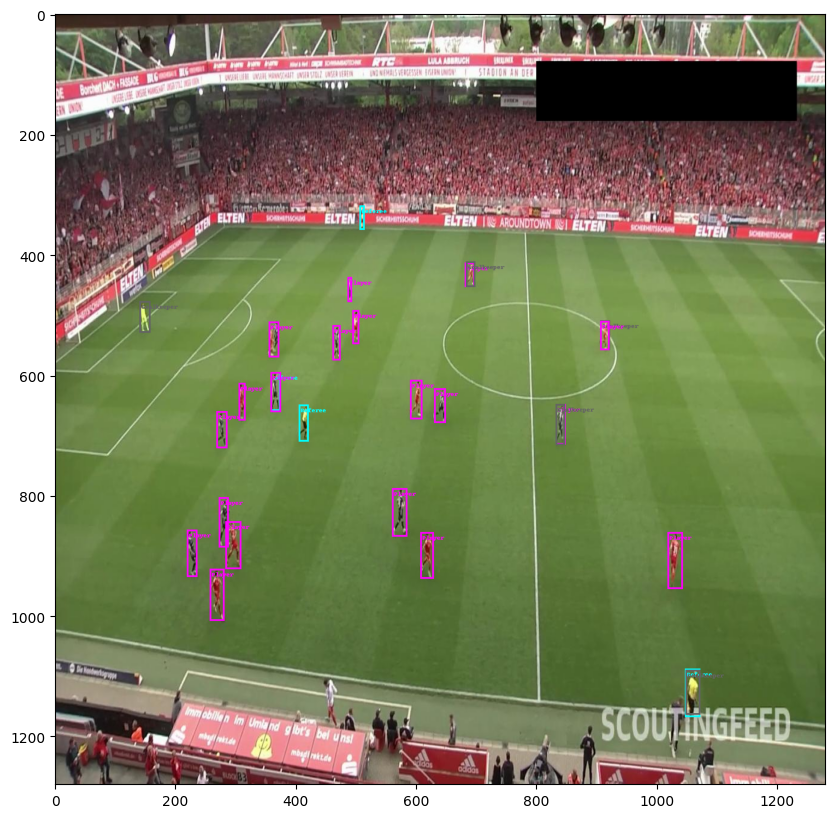

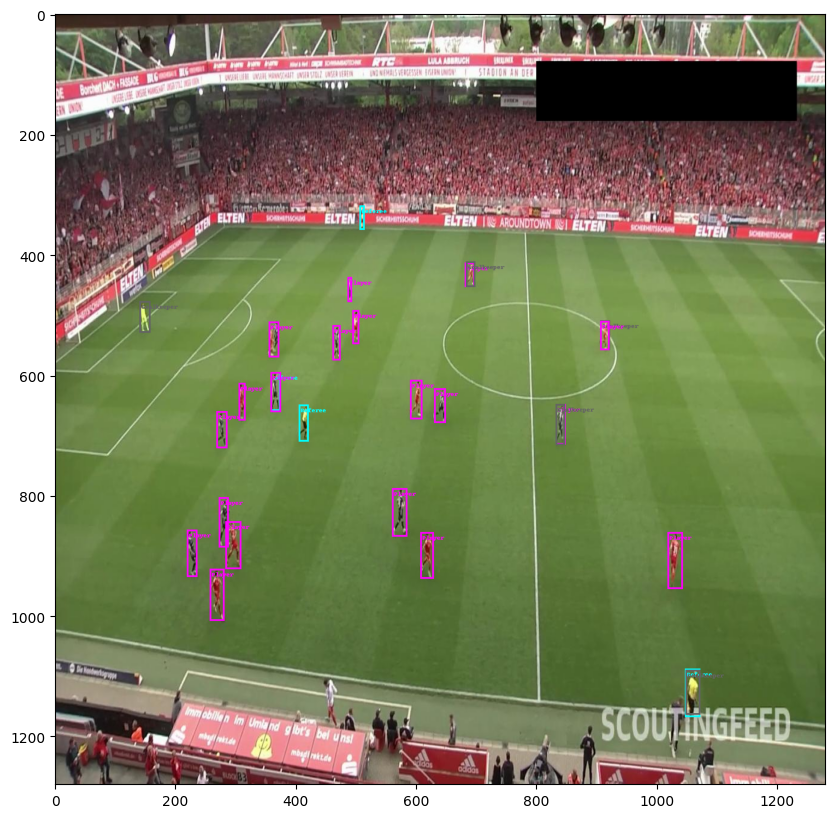

{'iou': tensor(0.0611, device='cuda:0')}
{'iou': tensor(0.0505, device='cuda:0')}
{'iou': tensor(0.0505, device='cuda:0')}


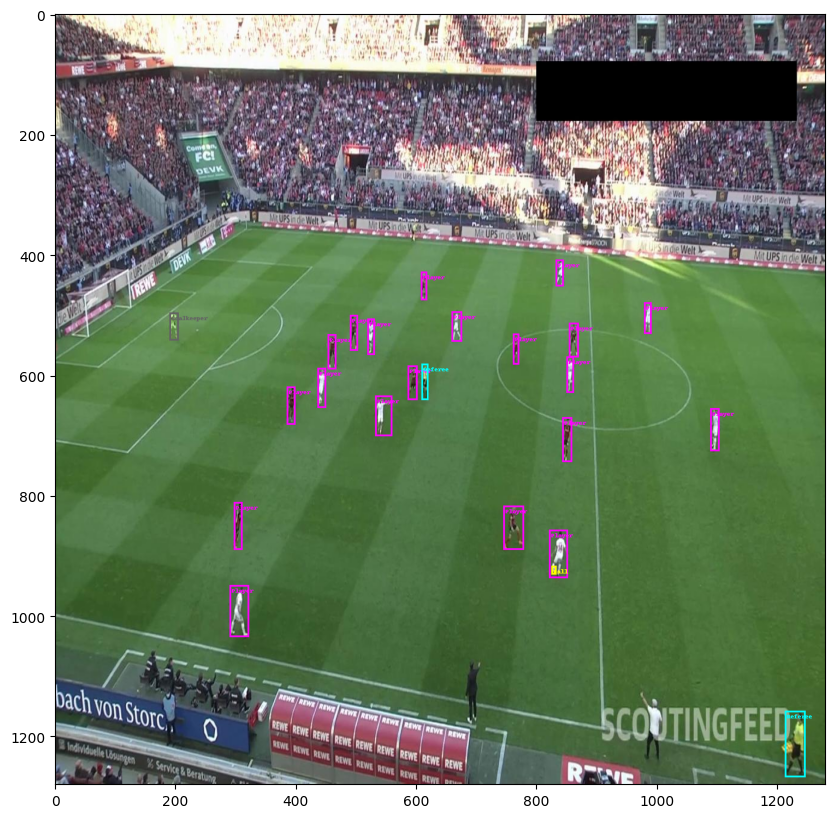

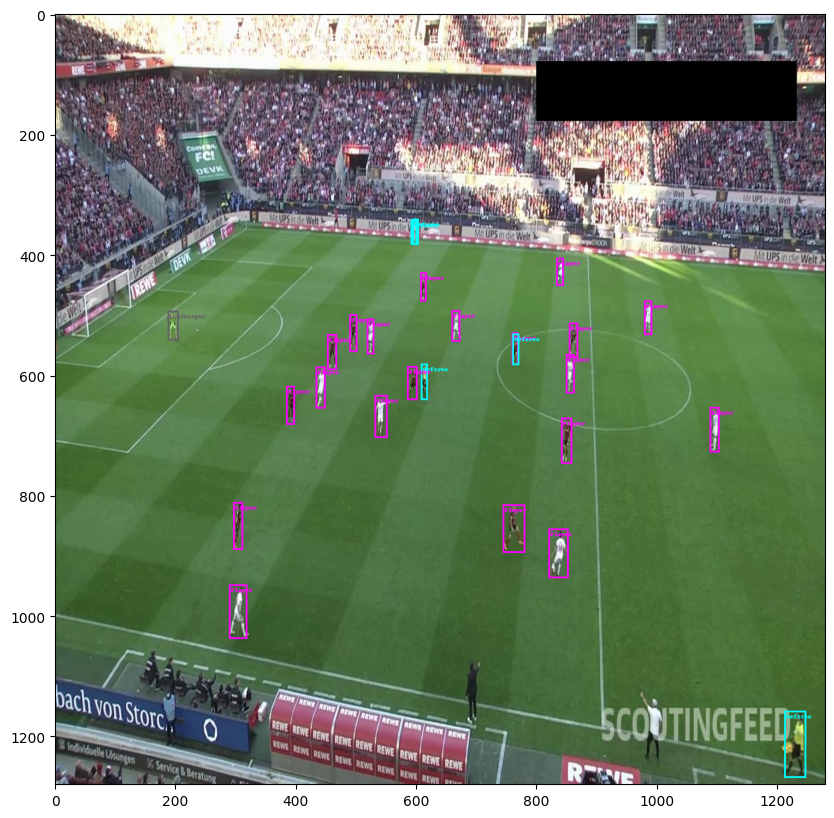

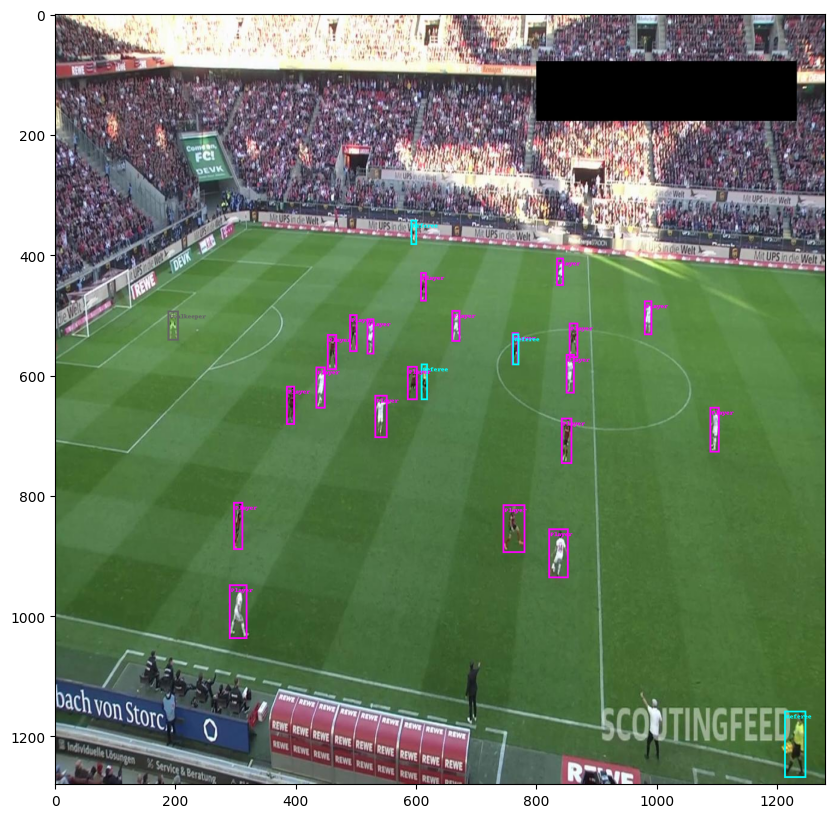

{'iou': tensor(0.0591, device='cuda:0')}
{'iou': tensor(0.0479, device='cuda:0')}
{'iou': tensor(0.0481, device='cuda:0')}


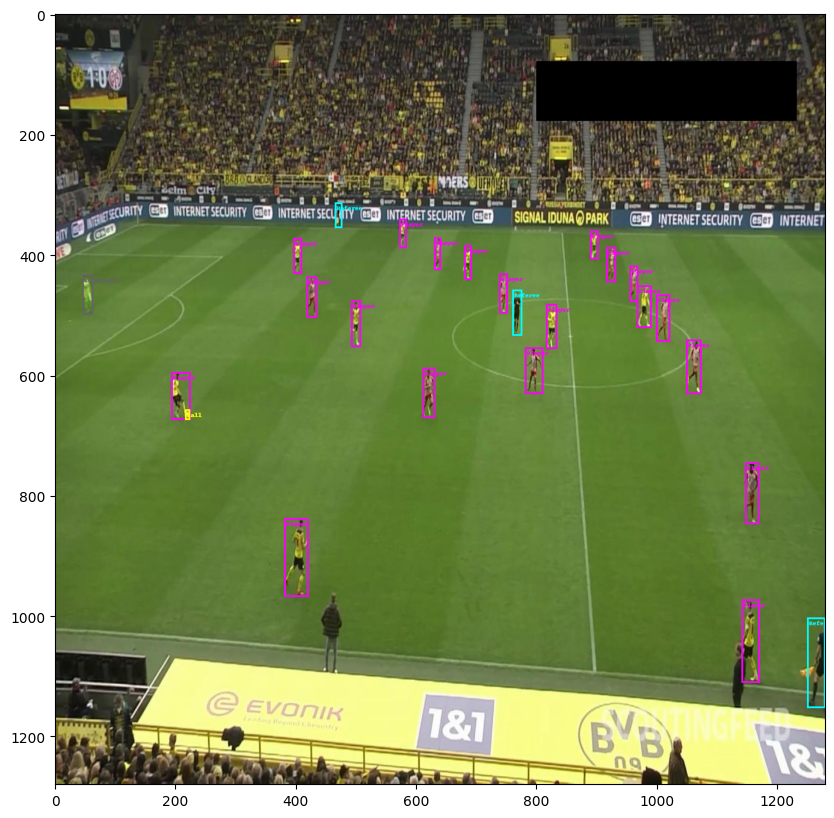

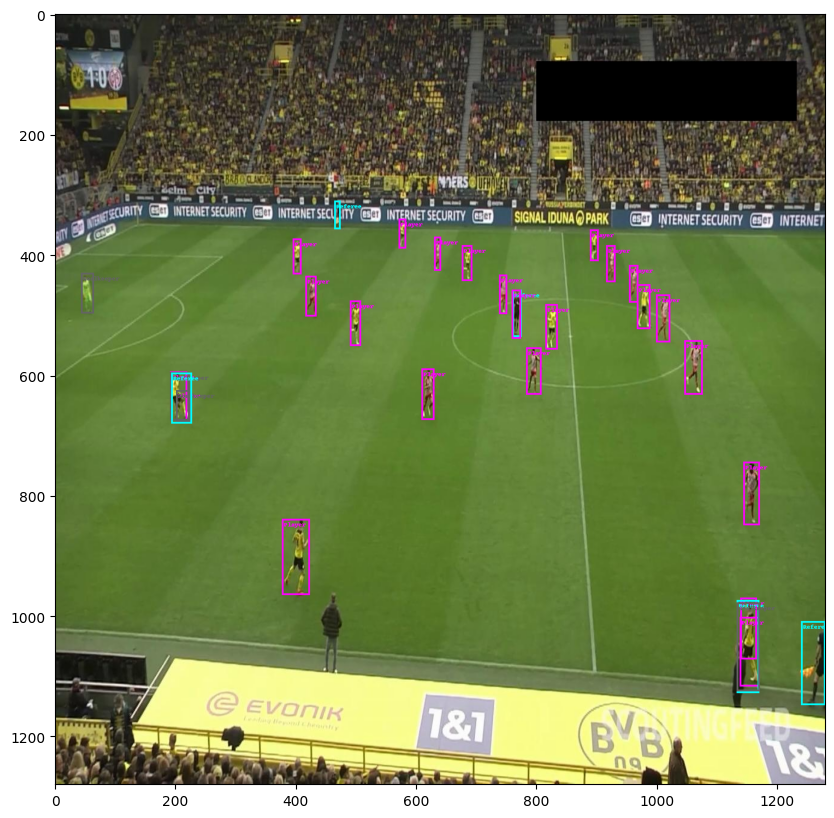

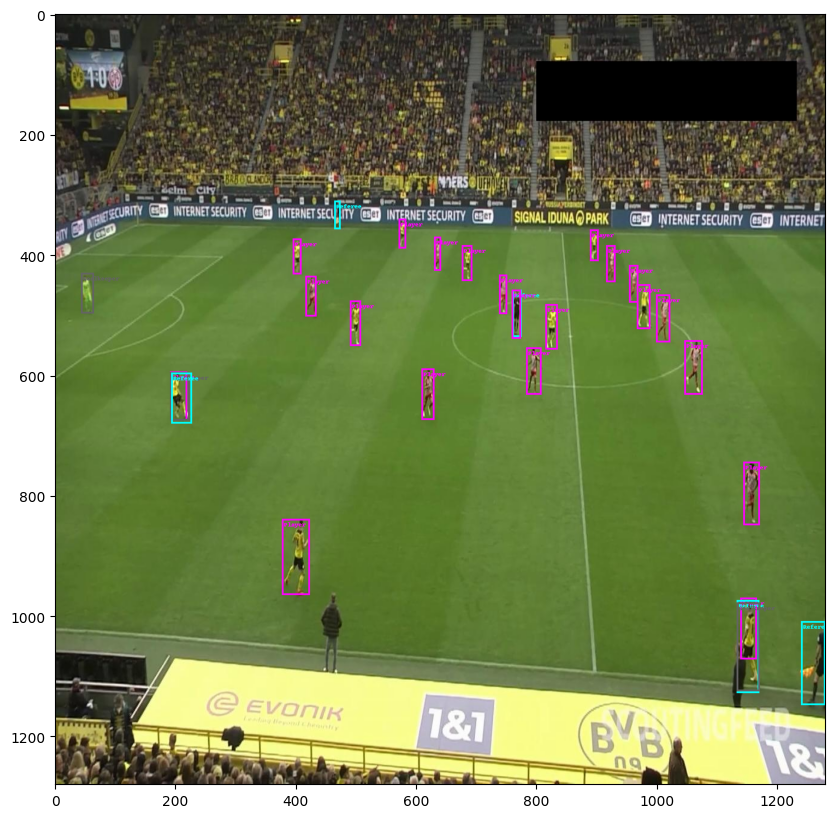

{'iou': tensor(0.0609, device='cuda:0')}
{'iou': tensor(0.0442, device='cuda:0')}
{'iou': tensor(0.0457, device='cuda:0')}


In [ ]:
from torchmetrics.detection import IntersectionOverUnion

model.eval()
with torch.no_grad():
    total_diff=0
    for imgs, annotations in test_dataloader:
        pred = model(imgs.cuda())
        target = [
            {
                "boxes": annotations['boxes'][0].to(device),
                "labels": annotations['labels'][0].to(device)
                }
            ]
        metric = IntersectionOverUnion()
        actual = metric(target, target)
        initial = metric(pred, target)
        draw_function(imgs, annotations['boxes'][0], list(annotations['labels'][0])) #the actual labels
        draw_function(imgs, pred[0]['boxes'], list(pred[0]['labels']))
        #print(initial)
        indices = torchvision.ops.batched_nms(boxes=pred[0]['boxes'], scores=pred[0]['scores'], idxs = pred[0]['labels'], iou_threshold = 0.01) #try batch and try training model more
        #indices = torchvision.ops.nms(boxes=pred[0]['boxes'][indices], scores = pred[0]['scores'][indices], iou_threshold=0.3) #do manual, then hyperparameter search
        boxes = pred[0]['boxes'][indices]
        labels = list(pred[0]['labels'][indices])
        pred[0]['boxes'] = boxes.to(device)
        pred[0]['labels'] = pred[0]['labels'][indices].to(device)
        final = metric(pred, target)
        draw_function(imgs, boxes, labels)
        #total_diff += (final-initial)
        print(actual)
        print(initial)
        print(final) #the bigger the negative, the better (0.0054)